# Fuel Cell - Battery Hybrid Heavy Payload and Long-Range VTOL Design

This script contains a sequence of optimizations for designing and analyzing a fuel Cell - battery hybrid evtol configuration. 

1. Preliminary sizing of powertrain components and the main wing and MTOW estimation
2. Main wing planform optimization
3. Tail design and sizing 
4. Fuselage design and sizing

Some useful links:

General problem structure is taken from Section 3 of "Geometric Programming for Aircraft Design Optimization" by W. Hoburg and P.
Abbeel. http://web.mit.edu/~whoburg/www/papers/hoburgabbeel2014.pdf

Several constants are tweaked in order to match the GPKit implementation available at: https://gpkit.readthedocs.io/en/latest/examples.html#simple-wing

1) Preliminary Sizing Constraint Analysis

In [69]:
import aerosandbox as asb
import aerosandbox.numpy as np

### Design Constants

# Propeller configuration constants
n_rotor_lifting = 4
n_rotor_nonlifting = 1

# Mass constants
m_payload = 5
m_BLDC = 0.5
m_ESC = 0.4
m_avionics = 0.5 # total mass of flight computers, sensors, and their connectors
m_electronics = 1 # total mass of power electronics and distribution components, including FCM DCDC converter

# Hover battery constants
V_cell = 3.8
N_cell = 12
e_den = 200

# Efficiency constants
k_motor = 0.9
k_ESC = 0.8
k_FCM = 0.55
k_DCDC = 0.9

# Hover propeller constants
CT = 0.08
CP = 0.03
min_rps = 1000/60
max_rps = 7000/60

# Gaseous hydrogen storage system constants
grav_den_H2 = 0.06 # Mass density of gaseous storage system
reserve_H2 = 0.10 # Additional hydrogen fuel reserved for maneuvres 
LHV_H2 = 120e6 # Lower heating value of hydrogen in J/mol
Z = 1.236 # hydrogen compressibility at 35 Pa and 298K
R = 8.314 # universal gas constant J/(K*mol)
M = 2.016 # molecular mass of hydrogen in g/mol
T = 298 # hydrogen storage temperature in K


# Main wing constants
oswalds_efficiency = 0.95  # Oswald efficiency factor [-]
airfoil_thickness_fraction = 0.12  # airfoil thickness to chord ratio [-]
ultimate_load_factor = 3.8  # ultimate load factor [-]
airspeed_takeoff = 22  # takeoff speed [m/s]
CL_max = 1.5  # max CL with flaps down [-]
wetted_area_ratio = 2.05  # wetted area ratio [-]
W_W_coeff1 = 1.45e-5 # Wing Weight Coefficient 1 [1/m]
W_W_coeff2 = 50.24  # Wing Weight Coefficient 2 [Pa]
g = 9.81 # acceleration due to gravity [m/s^2]
cruise_airspeed = 20 # cruise airspeed [m/s]

# Drag model constants
form_factor = 1.2  # form factor [-]
drag_area_fuselage = 0.031  # fuselage drag area [m^2]

# Flow constants
viscosity = 1.78e-5  # viscosity of air [kg/m/s]
density = 1.225  # density of air [kg/m^3]

### Initialize optimization environment

opti = asb.Opti()  # initialize an optimization environment

### Optimization Variables
aspect_ratio = opti.variable(init_guess=7, log_transform=True, lower_bound=5, upper_bound=9)
wing_area    = opti.variable(init_guess=3, log_transform=True, lower_bound=0.1, upper_bound=10)
weight       = opti.variable(init_guess=200, log_transform=True, lower_bound=0.1)       # [N]
CL           = opti.variable(init_guess=1, log_transform=True, lower_bound=0.01, upper_bound=CL_max)
C_pack       = opti.variable(init_guess=10, log_transform=True, lower_bound=0.01)        # [Ah]
m_H2_sys     = opti.variable(init_guess=3.5, log_transform=True, lower_bound=0.01, upper_bound=6)       # [kg of tank system]
m_FCM        = opti.variable(init_guess=3.5, log_transform=True, lower_bound=0.01, upper_bound=6)
P_tank       = opti.variable(init_guess=35e6, log_transform=True, lower_bound=10e6, upper_bound=40e6)
D_prop       = opti.variable(init_guess=20 * 0.0254, log_transform=True, lower_bound=10 * 0.0254, upper_bound=22 * 0.0254)

### Models

# Mass buildup model
m_battery = (C_pack * N_cell * V_cell)/e_den
m_components = (m_payload + (n_rotor_lifting+n_rotor_nonlifting)*(m_BLDC+m_ESC) + m_FCM + m_H2_sys + 
              m_avionics + m_electronics + m_battery) # total mass of components 
m_airframe = m_components * 0.4 # airframe mass excluding main wing is 40% of total mass of components 
m_fuselage = m_airframe + m_components
weight_fuselage = m_fuselage * g # total weight excluding main wing 

# Wing weight model
weight_wing_structural = W_W_coeff1 * (
        ultimate_load_factor * aspect_ratio ** 1.5 *
        (weight_fuselage * weight * wing_area) ** 0.5
) / airfoil_thickness_fraction
weight_wing_surface = W_W_coeff2 * wing_area
weight_wing = weight_wing_surface + weight_wing_structural # total weight of wing

# Aerodynamics model
CD_fuselage = drag_area_fuselage / wing_area
Re = (density / viscosity) * cruise_airspeed* (wing_area / aspect_ratio) ** 0.5
Cf = 0.074 / Re ** 0.2
CD_profile = form_factor * Cf * wetted_area_ratio
CD_induced = CL ** 2 / (np.pi * aspect_ratio * oswalds_efficiency)
CD = CD_fuselage + CD_profile + CD_induced
dynamic_pressure = 0.5 * density * cruise_airspeed** 2
drag = dynamic_pressure * wing_area * CD
lift_cruise = dynamic_pressure * wing_area * CL
lift_takeoff = 0.5 * density * wing_area * CL_max * airspeed_takeoff ** 2

# Cruise thrust and power model
thrust_required = drag
power_required = thrust_required * cruise_airspeed
k_tot = k_motor * k_ESC * k_FCM * k_DCDC
PR_fc = power_required/(k_motor * k_ESC * k_DCDC)
PR_den = PR_fc/m_FCM

# Hover endurance model
n_hover = np.sqrt((weight/4) / (CT * D_prop ** 4 * density))
P_hover = CP * (n_hover ** 3) * (D_prop ** 5) * density
t_hover = ((C_pack * N_cell * V_cell * k_motor * k_ESC) / (P_hover * n_rotor_lifting)) * 60

# Hydrogen storage model
m_H2_consumed = m_H2_sys * grav_den_H2 * (1 - reserve_H2)
m_H2_stored = (m_H2_sys * grav_den_H2) * 1000
V_tank = (Z*R*T*m_H2_stored)/(P_tank*M)

# Breguet-range
W_i = weight
W_f = W_i - m_H2_consumed*g
Range = (LHV_H2/g) * (lift_cruise/drag) * k_tot * np.log(W_i/W_f)
Range_km = Range/1000

# Wing span 
wing_span = np.sqrt(wing_area * aspect_ratio)

### Constraints
opti.subject_to([
    weight <= lift_cruise,
    weight <= lift_takeoff,
    weight == weight_fuselage + weight_wing,
    weight < 25*g,
    PR_den <= 800,
    PR_den > 0,
    n_hover < max_rps,
    t_hover >=5,
    V_tank < 0.012,
    wing_span < 4
])

# Objective
opti.minimize(1/Range_km)

sol = opti.solve(max_iter=100)

# Pull out values for further use
MTOW = sol(weight)
S = sol(wing_area)
b = sol(wing_span)
CL_cruise = sol(CL)
AR = sol(aspect_ratio)

This is Ipopt version 3.14.11, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:        6
Number of nonzeros in inequality constraint Jacobian.:       39
Number of nonzeros in Lagrangian Hessian.............:       32

Total number of variables............................:        9
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        1
Total number of inequality constraints...............:       25
        inequality constraints with only lower bounds:       11
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:       14

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.7221652e-03 2.33e+02 1.06e+00   0.0 0.00e+00    -  0.00e+00 0.00e+00 

In [70]:
## Test physics

# Hover performance
T_req = (density * CT * (n_hover ** 2) * (D_prop ** 4)) * 4
T_max = (density * CT * (max_rps ** 2) * (D_prop ** 4)) * 4
T_min = (density * CT * (min_rps ** 2) * (D_prop ** 4)) * 4

print(f"Min available thrust = {sol(T_min)} N")
print(f"Hovering thrust required = {sol(T_req)} N")
print(f"Max available thrust = {sol(T_max)} N")

# Cruise range 
W_i = sol(weight)
fuel_weight = sol(m_H2_consumed * g)
W_f = W_i - fuel_weight
Breuget_range = (LHV_H2/g) * (lift_cruise/drag) * k_tot * np.log(W_i/W_f)
print(f"Optimized cruise range = {sol(Breuget_range/1000)} km")



Min available thrust = 10.617180226524043 N
Hovering thrust required = 245.25000243123392 N
Max available thrust = 520.241831099678 N
Optimized cruise range = 93.8362700982332 km


In [71]:
## Display aircraft design parameters

print("VTOL Performance")
print(f"Hovering endurance = {sol(t_hover)} minutes")
print(f"Hovering rps = {sol(n_hover)} rps")
print(f"Maximized Range = {sol(Range_km)} km")
print(f"C_L at cruise = {sol(CL)}")
print(f"Lift to drag ratio = {sol(lift_cruise/drag)}\n")
print("Wing properties")
print(f"Aspect ratio = {sol(aspect_ratio)}")
print(f"Wing area = {sol(wing_area)} m^2")
print(f"Wing span = {sol(wing_span)} m\n")
print("Mass properties")
print(f"MTOW = {sol(weight)/g} kg")
print(f"Battery mass = {sol(m_battery)} kg")
print(f"FCM mass = {sol(m_FCM)} kg")
print(f"Components mass = {sol(m_components)} kg")
print(f"Airframe mass = {sol(m_airframe)} kg")
print(f"Wing mass = {sol(weight_wing/g)} kg\n")
print("Battery parameters")
print(f"Battery pack capacity = {sol(C_pack)} Ah\n")
print("Hydrogen storage system parameters")
print(f"Hydrogen storage system mass = {sol(m_H2_sys)} kg")
print(f"Hydrogen tank pressure = {sol(P_tank)/1e6} MPa")
print(f"Hydrogen tank volume = {sol(V_tank * 1000)} L\n")
print("Motor paramters")
print(f"Lifting motor power required = {sol(P_hover)} W\n")
print("Propeller parameters")
print(f"Propeller diameter = {sol(D_prop/0.0254)} inch\n")
print("Fuel cell module parameters")
print(f"Fuel cell power required = {sol(PR_fc)} W")
print(f"Fuel cell power density = {sol(PR_den)} W/kg")

VTOL Performance
Hovering endurance = 4.999999951882642 minutes
Hovering rps = 80.10297851640821 rps
Maximized Range = 93.8362700982332 km
C_L at cruise = 1.5000000141537841
Lift to drag ratio = 10.402570939541322

Wing properties
Aspect ratio = 9.00000018786039
Wing area = 0.667346939280589 m^2
Wing span = 2.4507391903042963 m

Mass properties
MTOW = 25.000000247832205 kg
Battery mass = 2.382328337242196 kg
FCM mass = 0.9095641473344566 kg
Components mass = 15.24881582843456 kg
Airframe mass = 6.099526331373824 kg
Wing mass = 3.6516580880238267 kg

Battery parameters
Battery pack capacity = 10.4488084966763 Ah

Hydrogen storage system parameters
Hydrogen storage system mass = 0.9569233438579076 kg
Hydrogen tank pressure = 22.42978744015103 MPa
Hydrogen tank volume = 3.8882794394527687 L

Motor paramters
Lifting motor power required = 1029.1658515927772 W

Propeller parameters
Propeller diameter = 22.00000042478726 inch

Fuel cell module parameters
Fuel cell power required = 727.651324

2) Main wing planform design

This section includes tools for analyzing airfoils, a predefined wing planform geometry, and tools for optimizing one


2.1. Airfoil analysis using XFOIL

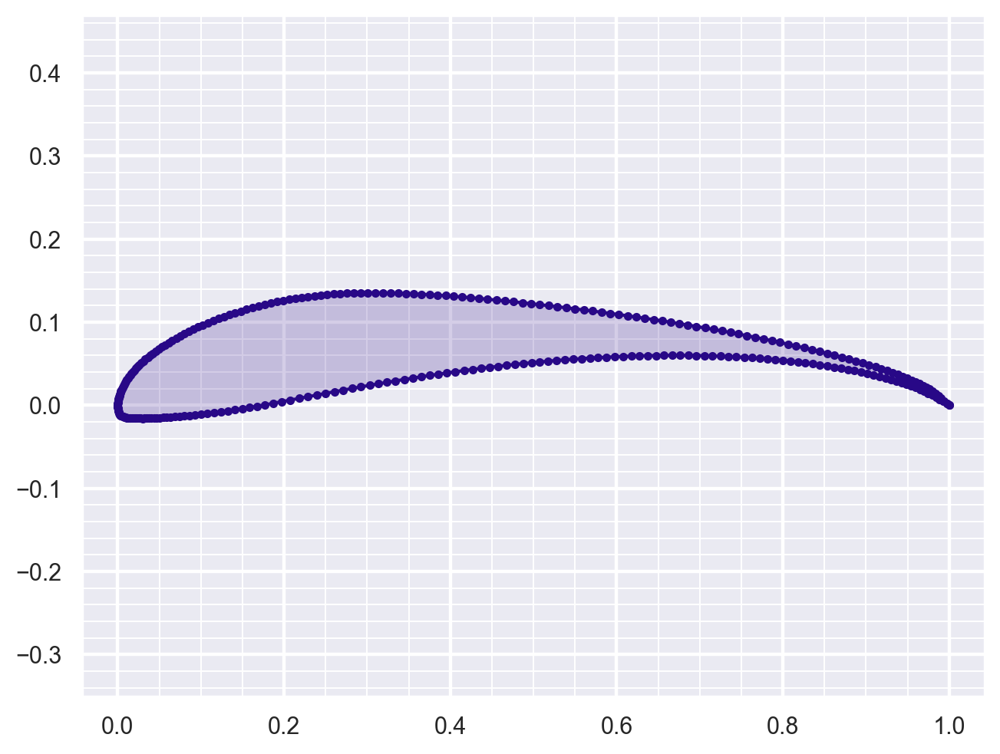

In [44]:
## Visualize an airfoil 

# Imports
from aerosandbox.tools.pretty_plots import plt, show_plot, set_ticks  # sets some nice defaults


airfoil = asb.Airfoil("s1223")  # Geometry will be automatically pulled from UIUC database (local).
fig, ax = plt.subplots()
airfoil.draw(show=False)
set_ticks(0.1, 0.05, 0.1, 0.05)
show_plot()


In [ ]:
from pprint import pprint


analysis = asb.XFoil(
        airfoil=airfoil,
        Re=3e5,
        xfoil_command=r"C:\Users\Berk\OneDrive - University of Toronto\Desktop\XFOIL\XFOIL.exe",
        # If XFOIL is not on your PATH, then set xfoil_command to the filepath to your XFOIL executable.
    )

point_analysis = analysis.alpha(
        alpha=3
    )

print("\nPoint analysis:")
pprint(point_analysis)

sweep_analysis = analysis.alpha(
        alpha=np.linspace(0, 15, 6)
    )
print("\nSweep analysis:")
pprint(sweep_analysis)

cl_analysis = analysis.cl(
        cl=1.2
    )
print("\nFixed-CL analysis:")
pprint(cl_analysis)


Point analysis:
{'Bot_Xtr': array([0.5402]),
 'CD': array([0.01866]),
 'CDp': array([0.01041]),
 'CL': array([1.5446]),
 'CM': array([-0.2747]),
 'Chinge': array([0.02786]),
 'Cpmin': array([-1.9136]),
 'Top_Xtr': array([0.4077]),
 'Xcpmin': array([0.1894]),
 'alpha': array([3.])}

Sweep analysis:
{'Bot_Xtr': array([0.2574, 0.5402, 1.    , 1.    , 1.    , 1.    ]),
 'CD': array([0.01587, 0.01866, 0.02202, 0.02664, 0.03403, 0.05704]),
 'CDp': array([0.00766, 0.01041, 0.0142 , 0.01925, 0.02773, 0.05197]),
 'CL': array([1.1862, 1.5446, 1.8619, 2.1281, 2.2725, 2.2902]),
 'CM': array([-0.271 , -0.2747, -0.2704, -0.2573, -0.2241, -0.1902]),
 'Chinge': array([0.02593, 0.02786, 0.02816, 0.02696, 0.02421, 0.026  ]),
 'Cpmin': array([-1.5016, -1.9136, -2.3761, -3.1711, -4.1033, -4.8625]),
 'Top_Xtr': array([0.4551, 0.4077, 0.3756, 0.3395, 0.2921, 0.2078]),
 'Xcpmin': array([0.2225, 0.1894, 0.1129, 0.0239, 0.0197, 0.0162]),
 'alpha': array([ 0.,  3.,  6.,  9., 12., 15.])}

Fixed-CL analysis:
{'B

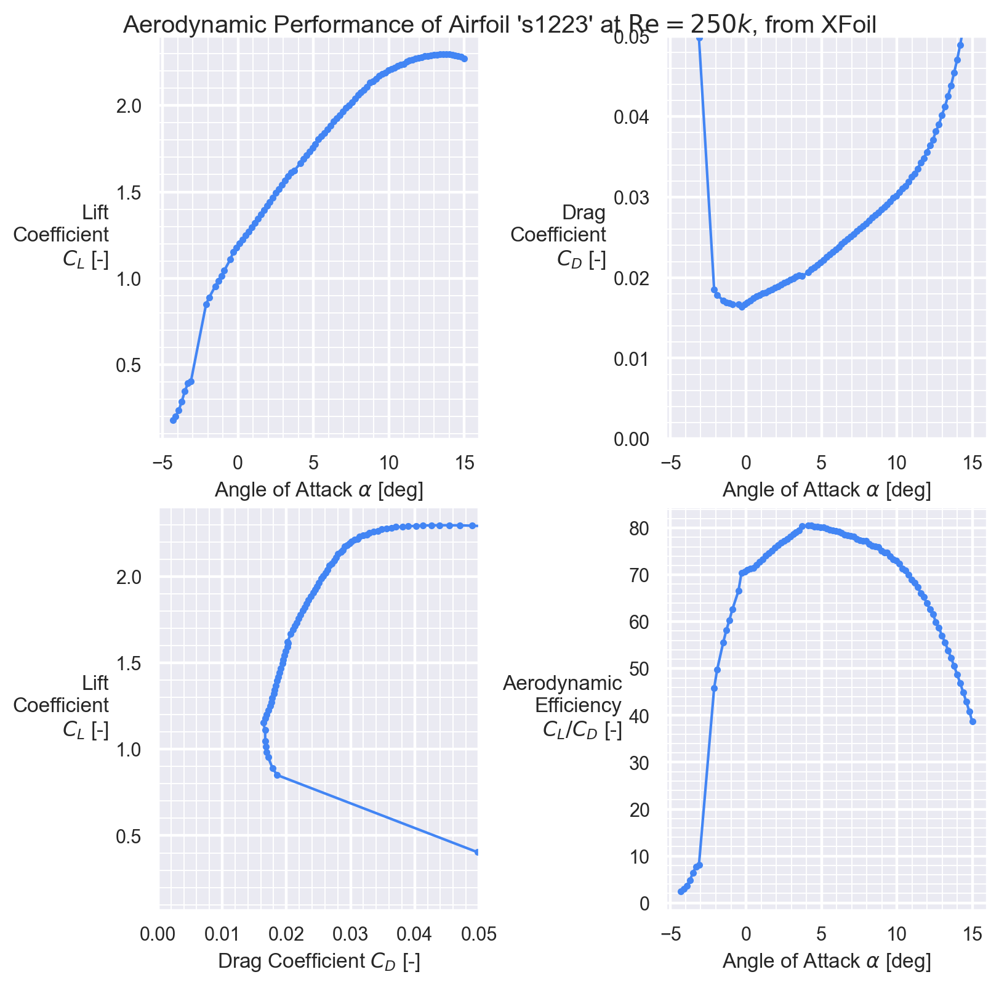

In [52]:
fig, ax = plt.subplots(2, 2, figsize=(8, 8))
Re = 250e3
alpha_inputs = np.linspace(-15, 15, 150)
xf_run = asb.XFoil(airfoil, Re=Re, max_iter=20, timeout=None, xfoil_command = r"C:\Users\Berk\OneDrive - University of Toronto\Desktop\XFOIL\XFOIL.exe").alpha(alpha_inputs)
xa = xf_run["alpha"]
xCL = xf_run["CL"]
xCD = xf_run["CD"]

plt.sca(ax[0, 0])
plt.plot(xa, xCL, ".-")
plt.xlabel(r"Angle of Attack $\alpha$ [deg]")
plt.ylabel(r"Lift Coefficient $C_L$ [-]")

plt.sca(ax[0, 1])
plt.plot(xa, xCD, ".-")
plt.xlabel(r"Angle of Attack $\alpha$ [deg]")
plt.ylabel(r"Drag Coefficient $C_D$ [-]")
plt.ylim(0, 0.05)

plt.sca(ax[1, 0])
plt.plot(xCD, xCL, ".-")
plt.xlabel(r"Drag Coefficient $C_D$ [-]")
plt.ylabel(r"Lift Coefficient $C_L$ [-]")
plt.xlim(0, 0.05)

plt.sca(ax[1, 1])
plt.plot(xa, xCL / xCD, ".-")
plt.xlabel(r"Angle of Attack $\alpha$ [deg]")
plt.ylabel(r"Aerodynamic Efficiency $C_L / C_D$ [-]")

from aerosandbox.tools.string_formatting import eng_string

show_plot(f"Aerodynamic Performance of Airfoil '{airfoil.name}' at $\\mathrm{{Re}}={eng_string(Re)}$, from XFoil")

2.2. Main wing aerodynamic analysis

0.34038043599292983
0.20422826159575788
1.2253695951521482


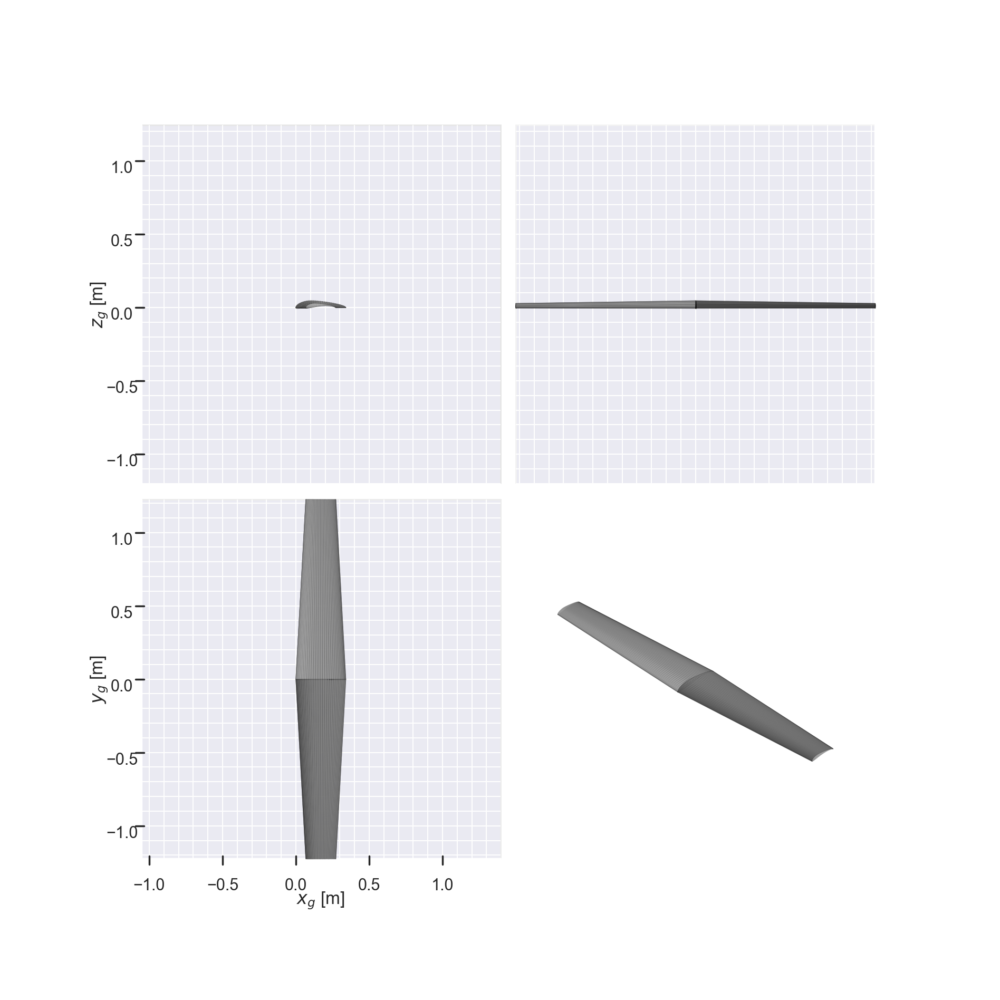

array([[<Axes3D: zlabel='$z_g$ [m]'>, <Axes3D: >],
       [<Axes3D: xlabel='$x_g$ [m]', ylabel='$y_g$ [m]'>, <Axes3D: >]],
      dtype=object)

In [72]:
# Parametrically define wing planform
S_wing = S
AR_wing = AR
b_wing = (S_wing * AR_wing) ** 0.5
taper_wing = 0.6 
c_root_wing = 2*S_wing/(b_wing*(1+taper_wing))
c_tip_wing = c_root_wing * taper_wing
mac_wing = (2/3) * c_root_wing * ((1 + taper_wing + taper_wing ** 2)/(1 + taper_wing))
quarter_chord_wing = mac_wing/4
mac_wing_y = (b_wing/6) * ((1 + 2*taper_wing)/(1 + taper_wing))
mac_wing_x = quarter_chord_wing + (mac_wing_y * ((c_root_wing - c_tip_wing)/2))/(b_wing/2)

print(c_root_wing)
print(c_tip_wing)
print(b_wing/2)

# Define wing and aircraft for display 
wing = asb.Wing(
            name="Wing",
            symmetric=True,
            xsecs=[
                asb.WingXSec(
                    xyz_le=[0,0,0],
                    chord=c_root_wing,
                    twist=0,
                    airfoil=asb.Airfoil("s1223"),
                    control_surface_is_symmetric=False,
                    control_surface_deflection=0,
                ),
                asb.WingXSec(
                    xyz_le=[(c_root_wing-c_tip_wing)/2, b_wing/2, 0],
                    chord=c_tip_wing,
                    twist=0,
                    airfoil=asb.Airfoil("s1223"),
                ),
            ]
        )

airplane = asb.Airplane( # Make an airplane object containing only this wing.
    wings=[
        wing
    ]
)

# Visualize wing planform
airplane.draw_three_view()

In [73]:
## Run operating point analysis using vortex lattice method

vlm = asb.VortexLatticeMethod(
    airplane=airplane,
    op_point=asb.OperatingPoint(
        velocity=20,  # m/s
        alpha=5,  # degree
    )
)

## Return results of the analysis
aero = vlm.run()  # Returns a dictionary
for k, v in aero.items():
    print(f"{k.rjust(4)} : {v}")

 F_g : [-8.88880538e+00  1.11022302e-15  2.37869888e+02]
 F_b : (np.float64(8.888805378414778), np.float64(1.1102230246251565e-15), np.float64(-237.8698877388001))
 F_w : (np.float64(-11.876745952830994), np.float64(1.1102230246251565e-15), np.float64(-237.73943143596648))
 M_g : [-2.20518048e-14 -3.95602239e+01 -1.28369537e-15]
 M_b : (np.float64(2.2051804826617172e-14), np.float64(-39.56022394769311), np.float64(1.2836953722228372e-15))
 M_w : (np.float64(2.2079772475257803e-14), np.float64(-39.56022394769311), np.float64(-6.431309048169126e-16))
   L : 237.73943143596648
   D : 11.876745952830994
   Y : 1.1102230246251565e-15
 l_b : 2.2051804826617172e-14
 m_b : -39.56022394769311
 n_b : 1.2836953722228372e-15
  CL : 1.454064801685349
  CD : 0.07264069802918625
  CY : 6.790359564576048e-18
  Cl : 5.5033810772269554e-17
  Cm : -0.8704260168071951
  Cn : 3.2036673986374664e-18


2.3. Main wing planform optimization

Find the wing shape that minimizes induced drag, with the following assumptions:

* A fixed lift
* A fixed wing area
* A fixed wing span
* An untwisted, uncambered, thin, planar wing
* Inviscid, incompressible, irrotational, steady flow

In [ ]:
opti = asb.Opti()  # Initialize an optimization environment.

N = 16  # Number of chord sections to optimize

# The y-locations (i.e. span locations) of each section. Note that the span is fixed.
section_y = np.sinspace(0, b/2, N, reverse_spacing=True)

# Using `sinspace` gives us better resolution near the wing tip.

1.2253695951521482


In [75]:
# Use a simple rectangular wing as our initial guess.
chords = opti.variable(init_guess=np.ones(N) * (S/b)) # All chords initially guessed as chord.

wing = asb.Wing(
    symmetric=True,
    xsecs=[
        asb.WingXSec(
            xyz_le=[
                -0.25 * chords[i], # This keeps the quarter-chord-line straight.
                section_y[i], # Our (known) span locations for each section.
                0
            ],
            chord=chords[i],
        )
        for i in range(N)
    ]
)

airplane = asb.Airplane( # Make an airplane object containing only this wing.
    wings=[
        wing
    ]
)

opti.subject_to([  # Let's add some sensible constraints.
    chords > 0,  # Chords should stay positive
    wing.area() == S,  # We want some fixed wing area
])

C:\Users\Berk\AppData\Local\Temp\ipykernel_21032\202269859.py:7: UserWarning: An airfoil is not specified for WingXSec. Defaulting to NACA 0012.
  asb.WingXSec(


[MX(fabs(opti6_lam_g_1)), MX(fabs(opti6_lam_g_2))]

Next, we'll add a constraint that requires the chord distribution to be monotonically decreasing, which is something we know from intuition. We can skip this constraint, but if we do, we need to have more than 1 VLM spanwise section per wing section in order to stabilize the solve (the optimization problem is less-well-posed otherwise, and hence can more easily "fall" into local minima).

In [76]:
opti.subject_to(
    np.diff(chords) <= 0 # The change in chord from one section to the next should be negative.
)

MX(fabs(opti6_lam_g_3))

We don't know the right angle of attack to get the desired lift coefficient a priori, so we'll make that an optimization variable too. Note the easy composability of aerodynamic shape optimization and operating point optimization.

Then, we set up and run the VLM solve.

In [77]:
alpha = opti.variable(init_guess=5, lower_bound=0, upper_bound=30)

op_point = asb.OperatingPoint(
    velocity=1, # Some fixed velocity; doesn't matter since we're working nondimensionally.
    alpha=alpha
)

vlm = asb.VortexLatticeMethod(
    airplane=airplane,
    op_point=op_point,
    spanwise_resolution=1,
    chordwise_resolution=8,
)

aero = vlm.run()

Finally, we add our lift constraint, set the optimization objective to minimize drag, and solve.

In [78]:
# NBVAL_SKIP
# (This tells our unit tests to skip this cell, as it's a bit wasteful to run on every commit.)

opti.subject_to(
    aero["CL"] == CL_cruise
)

opti.minimize(aero["CD"])

sol = opti.solve()

This is Ipopt version 3.14.11, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:       33
Number of nonzeros in inequality constraint Jacobian.:       48
Number of nonzeros in Lagrangian Hessian.............:      153

Total number of variables............................:       17
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        2
Total number of inequality constraints...............:       33
        inequality constraints with only lower bounds:       17
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:       16

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  6.1957517e-03 1.08e+00 3.05e-01   0.0 0.00e+00    -  0.00e+00 0.00e+00 

Let's visualize our solution.

The following command does an in-place substitution of our VLM object, recursively evaluating all its fields from abstract values to concrete ones (i.e., NumPy arrays) at our solution, using our `sol` object.

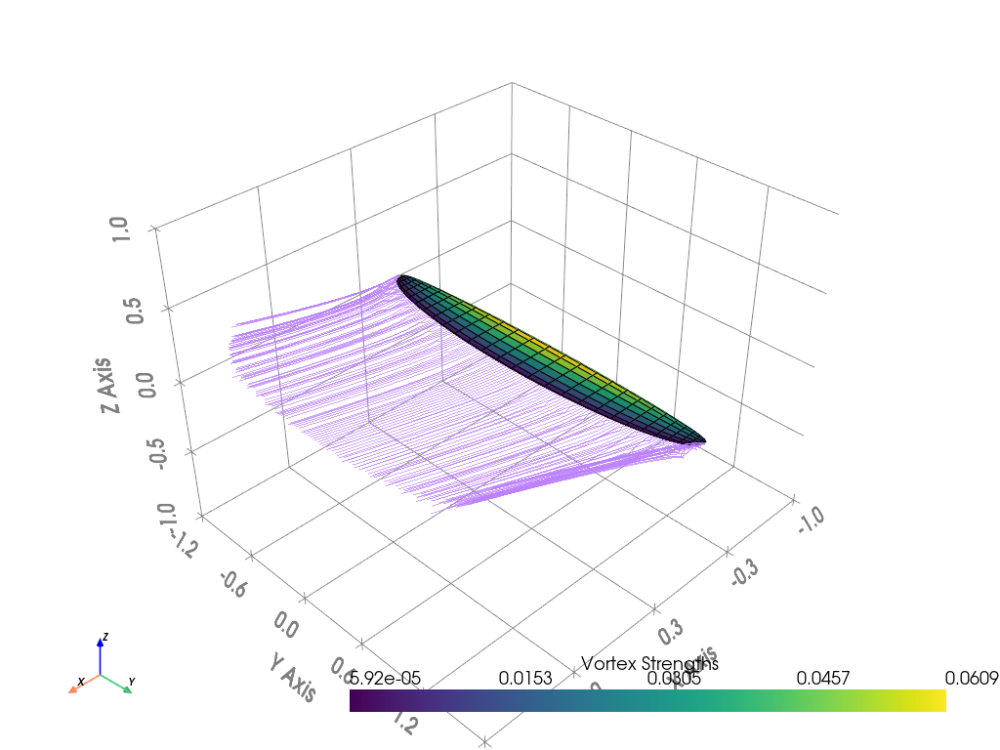

In [79]:
# NBVAL_SKIP
vlm = sol(vlm)

# NBVAL_SKIP
vlm.draw(show_kwargs=dict(jupyter_backend="static"))

In [80]:
## Run vlm on the optimized wing and return results

vlm = asb.VortexLatticeMethod(
    airplane=airplane,
    op_point=asb.OperatingPoint(
        velocity=20,  # m/s
        alpha=5,  # degree
    )
)

aero = vlm.run()  # Returns a dictionary
for k, v in aero.items():
    print(f"{k.rjust(4)} : {v}")


 F_g : @1=(0.272304*opti6_x_1), @2=vertcat((-0.25*@1[0]), 0, 0), @3=vertcat((-0.25*@1[1]), 0.128086, 0), @4=((0.975528*@2)+(0.0244717*@3)), @5=((0.904508*@2)+(0.0954915*@3)), @6=((0.793893*@2)+(0.206107*@3)), @7=((0.654508*@2)+(0.345492*@3)), @8=((0.5*@2)+(0.5*@3)), @9=((0.345492*@2)+(0.654508*@3)), @10=((0.206107*@2)+(0.793893*@3)), @11=((0.0954915*@2)+(0.904508*@3)), @12=((0.0244717*@2)+(0.975528*@3)), @13=vertcat((-0.25*@1[2]), 0.254769, 0), @14=((0.975528*@3)+(0.0244717*@13)), @15=((0.904508*@3)+(0.0954915*@13)), @16=((0.793893*@3)+(0.206107*@13)), @17=((0.654508*@3)+(0.345492*@13)), @18=((0.5*@3)+(0.5*@13)), @19=((0.345492*@3)+(0.654508*@13)), @20=((0.206107*@3)+(0.793893*@13)), @21=((0.0954915*@3)+(0.904508*@13)), @22=((0.0244717*@3)+(0.975528*@13)), @23=vertcat((-0.25*@1[3]), 0.37866, 0), @24=((0.975528*@13)+(0.0244717*@23)), @25=((0.904508*@13)+(0.0954915*@23)), @26=((0.793893*@13)+(0.206107*@23)), @27=((0.654508*@13)+(0.345492*@23)), @28=((0.5*@13)+(0.5*@23)), @29=((0.345492*@

3. Fuselage sizing

- Fuselage can be sized using several parameters. First, the size of the payload and the H2 tank must be determined. These parameters will put constraints of max fuselage lenght and diameter. 

- Fuselage length can be estimated from MTOW using a*W_o^c. 

- For a fixed internal volume, the subsonic drag is minimized by a fineness ratio of 3 and supersonic drag is minimized by a fineness ratio of 14. For a circular fuselage, the fineness ratio is defined by fuselage_lenght / fuselage diameter

In [81]:
## Typical a and C values for fuselage length estimation

# fuselage_a = 0.86 # sailplane - unpowered
# fuselage_a = 0.71 # sailplane - powered
# fuselage_a = 3.68 # homebuilt -metal/wood
# fuselage_a = 3.50 # homebuilt - composite
# fuselage_a = 4.37 # GA - single engine
# fuselage_a = 0.86 # GA - twin engine
# fuselage_a = 4.04 # agricultural aircraft

# fuselage_C = 0.48 # sailplane - unpowered
# fuselage_C = 0.48 # sailplane - powered
# fuselage_C = 0.23 # homebuilt -metal/wood
# fuselage_C = 0.23 # homebuilt - composite
# fuselage_C = 0.23 # GA - single engine
# fuselage_C = 0.42 # GA - twin engine
# fuselage_C = 0.23 # agricultural aircraft

# fineness = 10

# Hydrogen tank specs for a 3L tank
l_over_d = 453/113 # https://www.thinkru.com/product/Hydrogen-CylinderHydrogen-Tank.html
tank_l = 453/1000 # [m]
tank_d = 113/1000 # [m]


# fuselage_length = fuselage_a * MTOW ** fuselage_C
fuselage_length = tank_l * 2.5
print(fuselage_length)

# fuselage_diameter = fuselage_length / fineness
fuselage_diameter = tank_d * 2
print(fuselage_diameter)


1.1325
0.226


4. Tail Sizing 

Method implemented here is the tail volume coefficient method referenced in Raymer. To calculate tail size, the moment arm must be estimated. This can be approximated at this stage of design by a percent of the fuselage length as previously estimated: 

- For an aircraft with a front-mounted propeller engine, the tail arm is about 0.6 of the fuselage lenght. 

- For an aircraft with the engines on the wings, the tail arm is about 0.5-0.55 of the fuselage length. 

- For aft-mounted engines, the tail arm is about 0.45-0.5 of the fuselage length. 

- A sailplane has a tail moment arm of about 0.65 of the fuselage length.

- For a T-tail, the vertical tail volume coeff can be reduced by 0.05 due to the end-plate effect, and horizontal tail volume coefficient can be reduced by 0.05 due to clean air seen by the h-stab. 

- The horizontal tail volume coefficient for an H-tail can be reduced by 0.05.

- For an aircraft which uses V-tail, the required horizontal and vertical tail sizes should be estimated as above. Then, the V surfaces should be sized to provide the same total surface area as required for conventional tails. The tail dihedral angle should be set to the arctangent of the square root of the ratio bw the required vertical and horizontal tail areas. This should be near 45 deg.

In [82]:
## Typical tail volume coefficients

# c_HT = 0.5 # sailplane
c_HT = 0.5 # homebuilt
# c_HT = 0.7 # general aviation - single engine 
# c_HT = 0.8 # general aviation - single engine
# c_HT = 0.5 # agricultural

# c_VT = 0.02 # sailplane
c_VT = 0.04 # homebuilt
# c_VT = 0.04 # general aviation - single engine
# c_VT = 0.07 # general aviation - single engine
# c_VT = 0.04 # agricultural

## Typical moment arm percentages

# tail_arm_perc = 0.6 # front-mounted prop
# tail_arm_perc = 0.5 # wing-mounted prop [0.5-0.55]
# tail_arm_perc = 0.45 #c aft-mounted engines [0.45-0.5]

tail_arm_perc = 0.65

S_HT = (c_HT * S * (S/b)) / (fuselage_length * tail_arm_perc) # H-Stab area
S_VT = (c_VT * S * b) / (fuselage_length * tail_arm_perc) # V-Stab area

## Typical aspect ratios and taper ratios for stab surfaces 
H_stab_AR_range = np.arange(3.0, 7.0, 0.05)
H_stab_taper_range = np.arange(0.2, 0.6, 0.05)

V_stab_AR_range = np.arange(0.6, 3.0, 0.05)
V_stab_taper_range = np.arange(0.2, 0.8, 0.05)

# H_stab parameter identification

b_h_stab = (min(H_stab_AR_range) * S_HT) ** 0.5
b_v_stab = (min(V_stab_AR_range) * S_VT) ** 0.5

print(S_HT)
print(S_VT)


0.123431124958872
0.0888704118254134


5. Wing and Tail Aerodynamic Analysis

Wing area: 0.667346939280589
wing span: 2.4507391903042963
Wing root chord: 0.34038043599292983
Wing tip chord: 0.20422826159575788
Wing mac: 0.27797735606089263
Wing quarter chord: 0.06949433901522316
Wing mac spanwise location: 0.5616277311114013
Wing thirty percent chord: 0.08339320681826778

H-stab area: 0.123431124958872
H-stab span: 0.9261999343900639
H-stab root chord: 0.17195635820655666
H-stab tip chord: 0.09457599701360615
H-stab mac: 0.13701038863554674
H-stab quarter chord: 0.034252597158886684
H-stab mac spanwise location: 0.20914192066872409

V-stab area: 0.0888704118254134
V-stab span: 0.5120231585436051
V-stab root chord: 0.21695896548457821
V-stab tip chord: 0.13017537929074693
V-stab mac: 0.17718315514573885
V-stab quarter chord: 0.04429578878643471
V-stab mac spanwise location: 0.23467728099915233

Fuselage length: 1.1325
Fuselage radius: 0.113


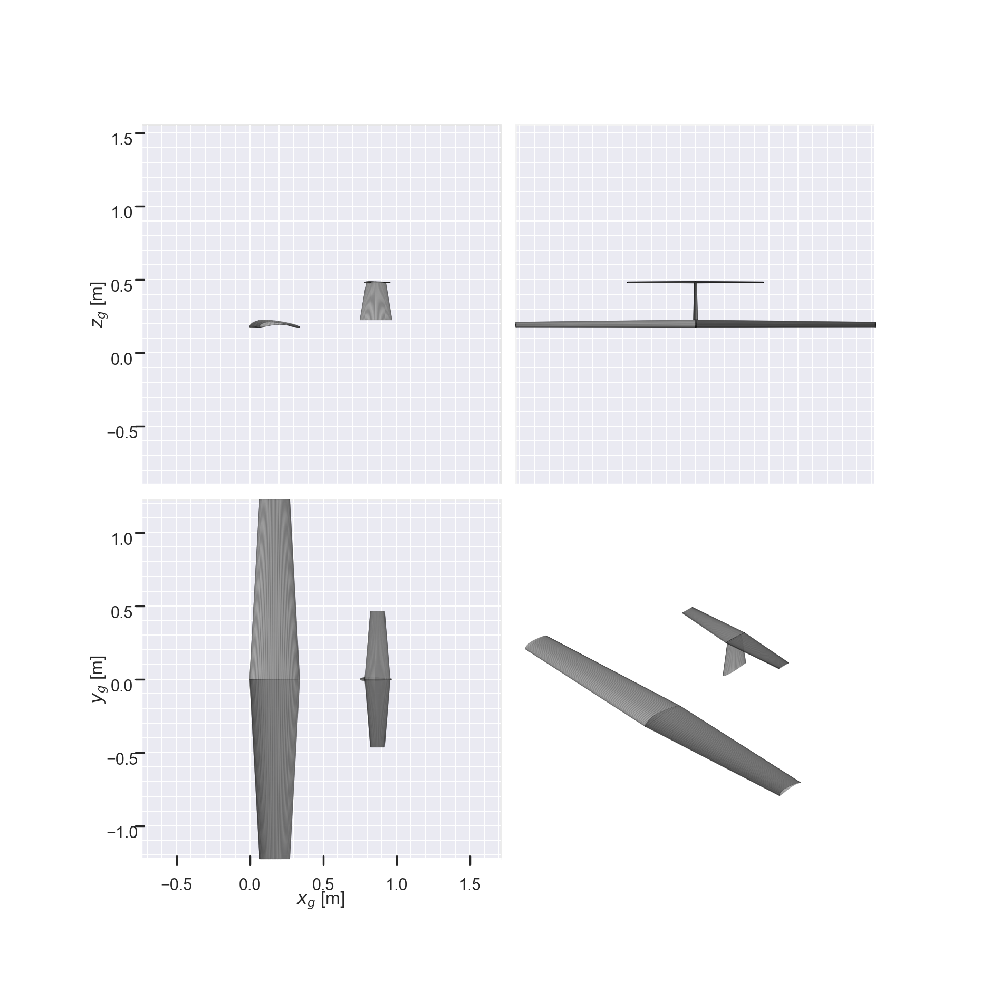

array([[<Axes3D: zlabel='$z_g$ [m]'>, <Axes3D: >],
       [<Axes3D: xlabel='$x_g$ [m]', ylabel='$y_g$ [m]'>, <Axes3D: >]],
      dtype=object)

In [83]:
# Main Wing parameters 
S_wing = S
AR_wing = AR
b_wing = (S_wing * AR_wing) ** 0.5
taper_wing = 0.6
c_root_wing = 2*S_wing/(b_wing*(1+taper_wing))
c_tip_wing = c_root_wing * taper_wing
mac_wing = (2/3) * c_root_wing * ((1 + taper_wing + taper_wing ** 2)/(1 + taper_wing))
quarter_chord_wing = mac_wing/4
thirty_percent_chord = mac_wing * 0.3
mac_wing_y = (b_wing/6) * ((1 + 2*taper_wing)/(1 + taper_wing))
mac_wing_x = quarter_chord_wing + (mac_wing_y * ((c_root_wing - c_tip_wing)/2))/(b_wing/2)

print("Wing area: " + str(S_wing))
print("wing span: " + str(b_wing))
print("Wing root chord: " + str(c_root_wing))
print("Wing tip chord: " + str(c_tip_wing))
print("Wing mac: " + str(mac_wing))
print("Wing quarter chord: " + str(quarter_chord_wing))
print("Wing mac spanwise location: " + str(mac_wing_y))
print("Wing thirty percent chord: " + str(thirty_percent_chord) + "\n")

# H-stab parameters  (same pattern)
S_hstab = S_HT; 
AR_hstab = max(H_stab_AR_range)
b_hstab = (S_hstab * AR_hstab) ** 0.5; 
taper_hstab = max(H_stab_taper_range)
c_root_hstab = 2*S_hstab/(b_hstab*(1+taper_hstab))
c_tip_hstab = c_root_hstab * taper_hstab
mac_hstab = (2/3) * c_root_hstab * ((1 + taper_hstab + taper_hstab**2)/(1 + taper_hstab))
quarter_chord_hstab = mac_hstab/4
mac_hstab_y = (b_hstab/6) * ((1 + 2*taper_hstab)/(1 + taper_hstab))
mac_hstab_x = quarter_chord_hstab + (mac_hstab_y * ((c_root_hstab - c_tip_hstab)/2))/(b_hstab/2)

print("H-stab area: " + str(S_hstab))
print("H-stab span: " + str(b_hstab))
print("H-stab root chord: " + str(c_root_hstab))
print("H-stab tip chord: " + str(c_tip_hstab))
print("H-stab mac: " + str(mac_hstab))
print("H-stab quarter chord: " + str(quarter_chord_hstab))
print("H-stab mac spanwise location: " + str(mac_hstab_y)+ "\n")

# V-stab parameters
S_vstab = S_VT; 
AR_vstab = max(V_stab_AR_range)
b_vstab = (S_vstab * AR_vstab) ** 0.5; 
taper_vstab = 0.6
c_root_vstab = 2*S_vstab/(b_vstab*(1+taper_vstab))
c_tip_vstab = c_root_vstab * taper_vstab
mac_vstab = (2/3) * c_root_vstab * ((1 + taper_vstab + taper_vstab**2)/(1 + taper_vstab))
quarter_chord_vstab = mac_vstab/4
mac_vstab_y = (b_vstab/3) * ((1 + 2*taper_vstab)/(1 + taper_vstab))
mac_vstab_x = quarter_chord_vstab + (mac_vstab_y * ((c_root_vstab - c_tip_vstab)/2))/(b_vstab/2)

print("V-stab area: " + str(S_vstab))
print("V-stab span: " + str(b_vstab))
print("V-stab root chord: " + str(c_root_vstab))
print("V-stab tip chord: " + str(c_tip_vstab))
print("V-stab mac: " + str(mac_vstab))
print("V-stab quarter chord: " + str(quarter_chord_vstab))
print("V-stab mac spanwise location: " + str(mac_vstab_y) + "\n")

# Define moment arms
l_hstab = fuselage_length * tail_arm_perc
h_stab_translate = mac_wing_x + l_hstab - mac_hstab_x
l_vstab = fuselage_length * tail_arm_perc
v_stab_translate = mac_wing_x + l_vstab - mac_vstab_x

# Fuselage parameters
fuselage_r = fuselage_diameter/2
fuselage_l = fuselage_length

print("Fuselage length: " + str(fuselage_l))
print("Fuselage radius: " + str(fuselage_r))

# --- Full airplane ---------------------------
airplane = asb.Airplane(
    name="Example Airplane",
    xyz_ref=[0,0,0],
    wings=[
        # Main Wing
        asb.Wing(
            name="Wing",
            symmetric=True,
            xsecs=[
                asb.WingXSec(
                    xyz_le=[0,0,0],
                    chord=c_root_wing,
                    twist=1,
                    airfoil=asb.Airfoil("s1223"),
                    control_surface_is_symmetric=False,
                    control_surface_deflection=0,
                ),
                asb.WingXSec(
                    xyz_le=[(c_root_wing-c_tip_wing)/2, b_wing/2, 0],
                    chord=c_tip_wing,
                    twist=-1,
                    airfoil=asb.Airfoil("s1223"),
                ),
            ]
        ).translate([0,0,fuselage_diameter*0.8]),
        # H-stab
        asb.Wing(
            name="H-stab",
            symmetric=True,
            xsecs=[
                asb.WingXSec(xyz_le=[0,0,0], chord=c_root_hstab, airfoil=asb.Airfoil("ht08")),
                asb.WingXSec(xyz_le=[(c_root_hstab-c_tip_hstab)/2, b_hstab/2, 0], chord=c_tip_hstab, airfoil=asb.Airfoil("ht08")),
            ]
        ).translate([h_stab_translate,0,b_vstab/2 + fuselage_diameter]),
        # V-stab
        asb.Wing(
            name="V-stab",
            symmetric=False,
            xsecs=[
                asb.WingXSec(xyz_le=[0,0,0], chord=c_root_vstab, airfoil=asb.Airfoil("naca0012")),
                asb.WingXSec(xyz_le=[(c_root_vstab-c_tip_vstab)/2,0,b_vstab/2], chord=c_tip_vstab, airfoil=asb.Airfoil("naca0012")),
            ]
        ).translate([v_stab_translate,0,fuselage_diameter]),
    ],
)

airplane.draw_three_view()


In [84]:
## Run VLM 
vlm = asb.VortexLatticeMethod(
    airplane=airplane,
    op_point=asb.OperatingPoint(
        velocity=20,  # m/s
        alpha=5,  # degree
    )
)

aero = vlm.run()  # Returns a dictionary
for k, v in aero.items():
    print(f"{k.rjust(4)} : {v}")

 F_g : [-8.88946967e+00 -4.65238974e-16  2.38168848e+02]
 F_b : (np.float64(8.889469673088017), np.float64(-4.652389744905483e-16), np.float64(-238.16884845424116))
 F_w : (np.float64(-11.90214032920618), np.float64(-4.652389744905483e-16), np.float64(-238.03731241272223))
 M_g : [ 3.07007546e-14 -4.02871011e+01 -1.19784193e-15]
 M_b : (np.float64(-3.0700754598682755e-14), np.float64(-40.28710113549198), np.float64(1.1978419287248434e-15))
 M_w : (np.float64(-3.0479530155631234e-14), np.float64(-40.28710113549198), np.float64(3.869030848509457e-15))
   L : 238.03731241272223
   D : 11.90214032920618
   Y : -4.652389744905483e-16
 l_b : -3.0700754598682755e-14
 m_b : -40.28710113549198
 n_b : 1.1978419287248434e-15
  CL : 1.4558839676406579
  CD : 0.07279587855477086
  CY : -2.8454949235352284e-18
  Cl : -7.661836203824125e-17
  Cm : -0.8864175057513866
  Cn : 2.9893951389573668e-18


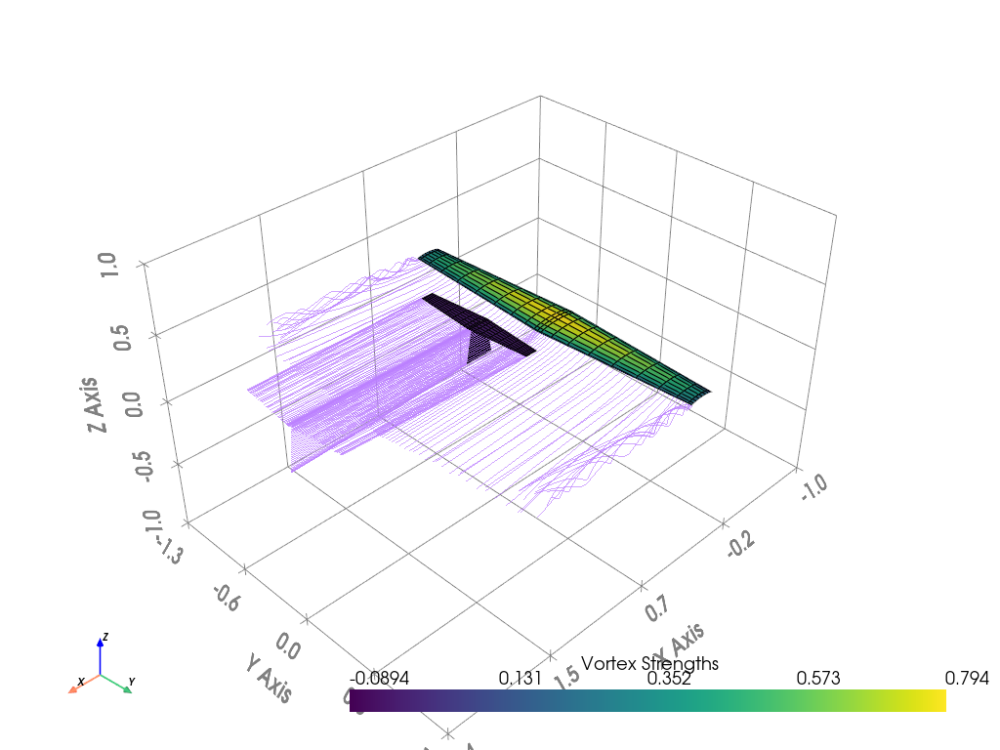

In [85]:
vlm.draw(show_kwargs=dict(jupyter_backend="static"))

6. Full airframe aerodynamic analysis

Fuselage length: 1.1325
Fuselage radius: 0.113


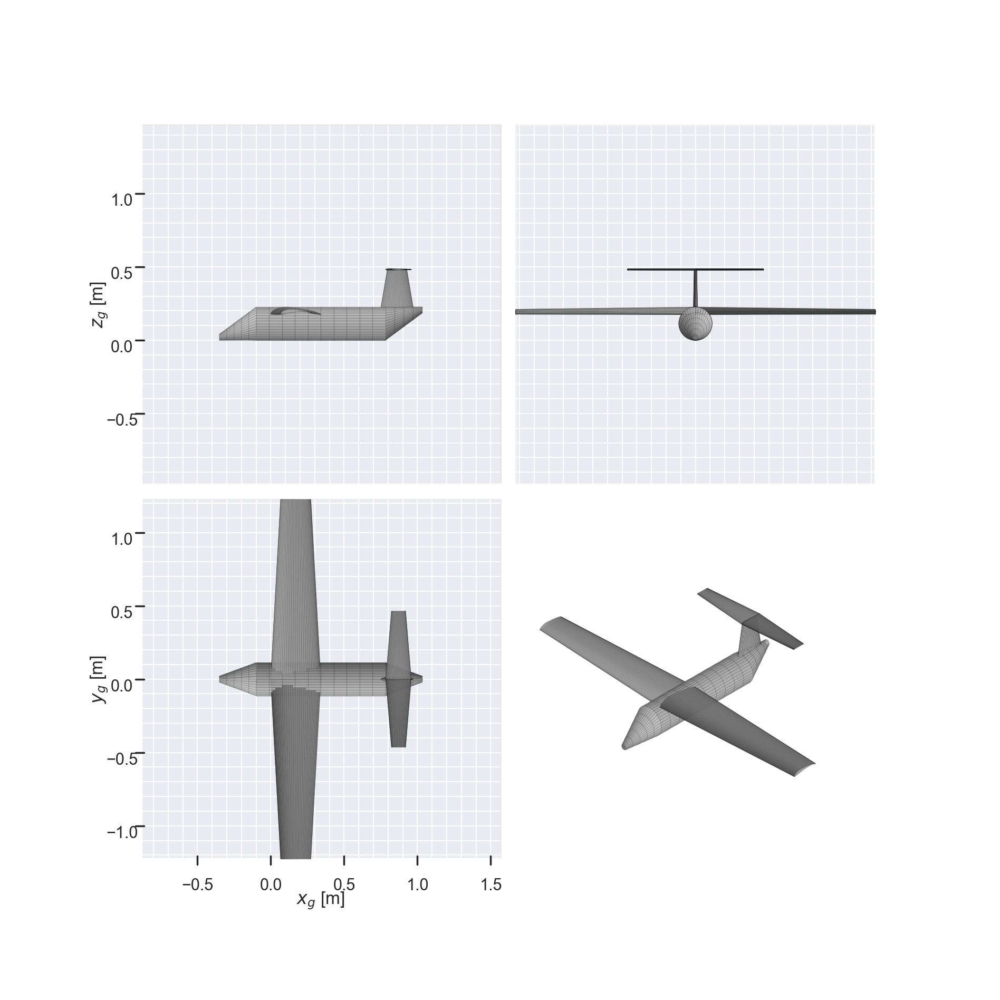

array([[<Axes3D: zlabel='$z_g$ [m]'>, <Axes3D: >],
       [<Axes3D: xlabel='$x_g$ [m]', ylabel='$y_g$ [m]'>, <Axes3D: >]],
      dtype=object)

In [99]:
import numpy as np
import aerosandbox as asb

# Main Wing parameters 
S_wing = S
AR_wing = AR
b_wing = (S_wing * AR_wing) ** 0.5
taper_wing = 0.6
c_root_wing = 2*S_wing/(b_wing*(1+taper_wing))
c_tip_wing = c_root_wing * taper_wing
mac_wing = (2/3) * c_root_wing * ((1 + taper_wing + taper_wing ** 2)/(1 + taper_wing))
quarter_chord_wing = mac_wing/4
thirty_percent_chord = mac_wing * 0.3
mac_wing_y = (b_wing/6) * ((1 + 2*taper_wing)/(1 + taper_wing))
mac_wing_x = quarter_chord_wing + (mac_wing_y * ((c_root_wing - c_tip_wing)/2))/(b_wing/2)

# H-stab parameters  (same pattern)
S_hstab = S_HT; 
AR_hstab = max(H_stab_AR_range)
b_hstab = (S_hstab * AR_hstab) ** 0.5; 
taper_hstab = max(H_stab_taper_range)
c_root_hstab = 2*S_hstab/(b_hstab*(1+taper_hstab))
c_tip_hstab = c_root_hstab * taper_hstab
mac_hstab = (2/3) * c_root_hstab * ((1 + taper_hstab + taper_hstab**2)/(1 + taper_hstab))
quarter_chord_hstab = mac_hstab/4
mac_hstab_y = (b_hstab/6) * ((1 + 2*taper_hstab)/(1 + taper_hstab))
mac_hstab_x = quarter_chord_hstab + (mac_hstab_y * ((c_root_hstab - c_tip_hstab)/2))/(b_hstab/2)

# V-stab parameters
S_vstab = S_VT; 
AR_vstab = max(V_stab_AR_range)
b_vstab = (S_vstab * AR_vstab) ** 0.5; 
taper_vstab = 0.6
c_root_vstab = 2*S_vstab/(b_vstab*(1+taper_vstab))
c_tip_vstab = c_root_vstab * taper_vstab
mac_vstab = (2/3) * c_root_vstab * ((1 + taper_vstab + taper_vstab**2)/(1 + taper_vstab))
quarter_chord_vstab = mac_vstab/4
mac_vstab_y = (b_vstab/3) * ((1 + 2*taper_vstab)/(1 + taper_vstab))
mac_vstab_x = quarter_chord_vstab + (mac_vstab_y * ((c_root_vstab - c_tip_vstab)/2))/(b_vstab/2)

# Define moment arms
l_hstab = fuselage_length * tail_arm_perc
h_stab_translate = mac_wing_x + l_hstab - mac_hstab_x
l_vstab = fuselage_length * tail_arm_perc
v_stab_translate = mac_wing_x + l_vstab - mac_vstab_x

# Fuselage parameters
fuselage_r = fuselage_diameter/2
fuselage_l = fuselage_length

print("Fuselage length: " + str(fuselage_l))
print("Fuselage radius: " + str(fuselage_r))

## Define fuselage geometry

# Discretization per region
n_front, n_mid, n_aft = 5, 10, 5

# Taper specs
l_front, r_front = 0.25, 0.02   # nose taper length & nose radius
l_aft,   r_aft   = 0.25, 0.02   # tail taper length & tail radius

# x-stations (origin at wing LE, +x aft)
x_front = np.linspace(-l_front,      0,            n_front, endpoint=False)
x_mid   = np.linspace(  0,      fuselage_l - l_aft, n_mid,   endpoint=False)
x_aft   = np.linspace(fuselage_l - l_aft, fuselage_l, n_aft)

x_positions = np.concatenate([x_front, x_mid, x_aft])

# Radius profile
def r_profile(x):
    if x < 0:
        # nose taper: r goes from r_front @ x=-l_front to fuselage_r @ x=0
        return r_front + (fuselage_r - r_front) * ((x + l_front)/l_front)
    elif x <= fuselage_l - l_aft:
        # constant mid-section
        return fuselage_r
    else:
        # tail taper: r from fuselage_r @ x=(L-l_aft) to r_aft @ x=L
        return fuselage_r + (r_aft - fuselage_r) * ((x - (fuselage_l - l_aft))/l_aft)

# Centerline height profile (to keep bottom straight front, top straight aft)
def zc_profile(x, r):
    if x < 0:
        # bottom at z=0 → center at z=r
        return r
    elif x <= fuselage_l - l_aft:
        # mid: centerline at z=fuselage_r
        return fuselage_r
    else:
        # top at z=2*fuselage_r → center at z=2*fuselage_r - r
        return 2*fuselage_r - r

# Build the FuselageXSec list:
xsecs = []
for x in x_positions:
    r  = r_profile(x)
    zc = zc_profile(x, r)
    xsecs.append(
        asb.FuselageXSec(
            xyz_c=[x, 0, zc],
            radius=r
        )
    )

# --- Full airplane ---------------------------
airplane = asb.Airplane(
    name="Example Airplane",
    xyz_ref=[0,0,0],
    wings=[
        # Main Wing
        asb.Wing(
            name="Wing",
            symmetric=True,
            xsecs=[
                asb.WingXSec(
                    xyz_le=[0,0,0],
                    chord=c_root_wing,
                    twist=1,
                    airfoil=asb.Airfoil("s1223"),
                    control_surface_is_symmetric=False,
                    control_surface_deflection=0,
                ),
                asb.WingXSec(
                    xyz_le=[(c_root_wing-c_tip_wing)/2, b_wing/2, 0],
                    chord=c_tip_wing,
                    twist=-1,
                    airfoil=asb.Airfoil("s1223"),
                ),
            ]
        ).translate([0,0,fuselage_diameter*0.8]),
        # H-stab
        asb.Wing(
            name="H-stab",
            symmetric=True,
            xsecs=[
                asb.WingXSec(xyz_le=[0,0,0], chord=c_root_hstab, airfoil=asb.Airfoil("ht08")),
                asb.WingXSec(xyz_le=[(c_root_hstab-c_tip_hstab)/2, b_hstab/2, 0], chord=c_tip_hstab, airfoil=asb.Airfoil("ht08")),
            ]
        ).translate([h_stab_translate,0,b_vstab/2 + fuselage_diameter]),
        # V-stab
        asb.Wing(
            name="V-stab",
            symmetric=False,
            xsecs=[
                asb.WingXSec(xyz_le=[0,0,0], chord=c_root_vstab, airfoil=asb.Airfoil("naca0012")),
                asb.WingXSec(xyz_le=[(c_root_vstab-c_tip_vstab)/2,0,b_vstab/2], chord=c_tip_vstab, airfoil=asb.Airfoil("naca0012")),
            ]
        ).translate([v_stab_translate,0,fuselage_diameter]),
    ],
    fuselages=[
        asb.Fuselage(
            name="Fuselage",
            xsecs=xsecs
        ).translate([-0.1,0,0]),
    ]
)

airplane.draw_three_view()


In [102]:
aero = asb.AeroBuildup(
    airplane=airplane,
    op_point=asb.OperatingPoint(
        velocity=20,
        alpha=5,
    ),
).run()

aero

{'F_g': [array([1.02758753]), array([-3.25508856e-15]), array([278.65074712])],
 'M_g': [array([1.11577466e-15]),
  array([-50.80977683]),
  array([-2.59184716e-15])],
 'F_b': (array([-1.02758753]),
  array([-3.25508856e-15]),
  array([-278.65074712])),
 'F_w': (array([-25.30969008]),
  array([-3.25508856e-15]),
  array([-277.50083675])),
 'M_b': (array([-1.11577466e-15]),
  array([-50.80977683]),
  array([2.59184716e-15])),
 'M_w': (array([-8.8563444e-16]),
  array([-50.80977683]),
  array([2.67923057e-15])),
 'L': array([277.50083675]),
 'Y': array([-3.25508856e-15]),
 'D': array([25.30969008]),
 'l_b': array([-1.11577466e-15]),
 'm_b': array([-50.80977683]),
 'n_b': array([2.59184716e-15]),
 'CL': array([1.6972508]),
 'CY': array([-1.99087748e-17]),
 'CD': array([0.15479914]),
 'Cl': array([-2.7845839e-18]),
 'Cm': array([-1.11794282]),
 'Cn': array([6.46834537e-18]),
 'wing_aero_components': [AeroComponentResults(
  	L=[266.22154796],
  	Y=[0.],
  	D=[3.1157002],
  	l_b=[-0.],
  	m

7. Full aircraft with optimized wing aerodynamic analysis

Fuselage length: 1.1325
Fuselage radius: 0.113


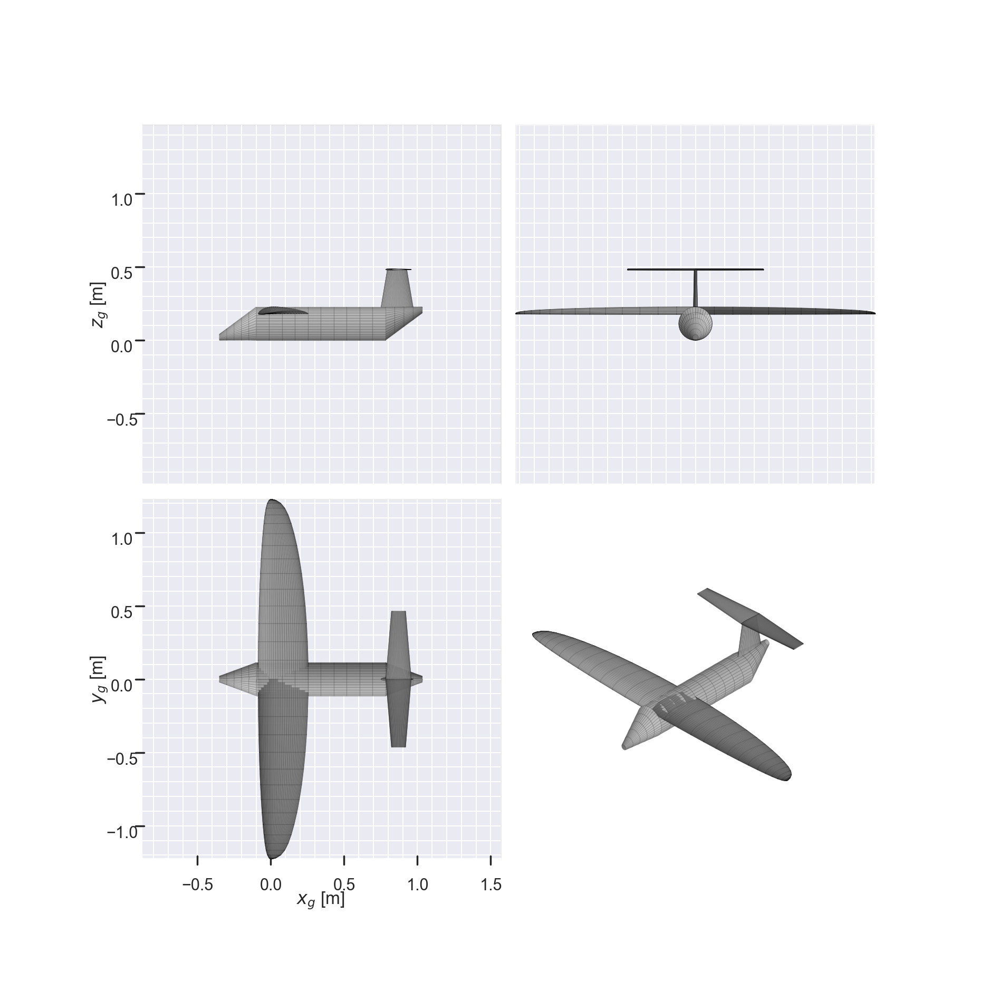

array([[<Axes3D: zlabel='$z_g$ [m]'>, <Axes3D: >],
       [<Axes3D: xlabel='$x_g$ [m]', ylabel='$y_g$ [m]'>, <Axes3D: >]],
      dtype=object)

In [103]:
## Draw the optimal wing planform and analyze it 

import numpy as np
import aerosandbox as asb

# Optimal Main Wing parameters 
opt_chords = sol.value(chords)
opt_section_y = sol.value(section_y)


# H-stab parameters  (same pattern)
S_hstab = S_HT; 
AR_hstab = max(H_stab_AR_range)
b_hstab = (S_hstab * AR_hstab) ** 0.5; 
taper_hstab = max(H_stab_taper_range)
c_root_hstab = 2*S_hstab/(b_hstab*(1+taper_hstab))
c_tip_hstab = c_root_hstab * taper_hstab
mac_hstab = (2/3) * c_root_hstab * ((1 + taper_hstab + taper_hstab**2)/(1 + taper_hstab))
quarter_chord_hstab = mac_hstab/4
mac_hstab_y = (b_hstab/6) * ((1 + 2*taper_hstab)/(1 + taper_hstab))
mac_hstab_x = quarter_chord_hstab + (mac_hstab_y * ((c_root_hstab - c_tip_hstab)/2))/(b_hstab/2)

# V-stab parameters
S_vstab = S_VT; 
AR_vstab = max(V_stab_AR_range)
b_vstab = (S_vstab * AR_vstab) ** 0.5; 
taper_vstab = 0.6
c_root_vstab = 2*S_vstab/(b_vstab*(1+taper_vstab))
c_tip_vstab = c_root_vstab * taper_vstab
mac_vstab = (2/3) * c_root_vstab * ((1 + taper_vstab + taper_vstab**2)/(1 + taper_vstab))
quarter_chord_vstab = mac_vstab/4
mac_vstab_y = (b_vstab/3) * ((1 + 2*taper_vstab)/(1 + taper_vstab))
mac_vstab_x = quarter_chord_vstab + (mac_vstab_y * ((c_root_vstab - c_tip_vstab)/2))/(b_vstab/2)

# Define moment arms
l_hstab = fuselage_length * tail_arm_perc
h_stab_translate = mac_wing_x + l_hstab - mac_hstab_x
l_vstab = fuselage_length * tail_arm_perc
v_stab_translate = mac_wing_x + l_vstab - mac_vstab_x

# Fuselage parameters
fuselage_r = fuselage_diameter/2
fuselage_l = fuselage_length

print("Fuselage length: " + str(fuselage_l))
print("Fuselage radius: " + str(fuselage_r))

## Define fuselage geometry

# Discretization per region
n_front, n_mid, n_aft = 5, 10, 5

# Taper specs
l_front, r_front = 0.25, 0.02   # nose taper length & nose radius
l_aft,   r_aft   = 0.25, 0.02   # tail taper length & tail radius

# x-stations (origin at wing LE, +x aft)
x_front = np.linspace(-l_front,      0,            n_front, endpoint=False)
x_mid   = np.linspace(  0,      fuselage_l - l_aft, n_mid,   endpoint=False)
x_aft   = np.linspace(fuselage_l - l_aft, fuselage_l, n_aft)

x_positions = np.concatenate([x_front, x_mid, x_aft])

# Radius profile
def r_profile(x):
    if x < 0:
        # nose taper: r goes from r_front @ x=-l_front to fuselage_r @ x=0
        return r_front + (fuselage_r - r_front) * ((x + l_front)/l_front)
    elif x <= fuselage_l - l_aft:
        # constant mid-section
        return fuselage_r
    else:
        # tail taper: r from fuselage_r @ x=(L-l_aft) to r_aft @ x=L
        return fuselage_r + (r_aft - fuselage_r) * ((x - (fuselage_l - l_aft))/l_aft)

# Centerline height profile (to keep bottom straight front, top straight aft)
def zc_profile(x, r):
    if x < 0:
        # bottom at z=0 → center at z=r
        return r
    elif x <= fuselage_l - l_aft:
        # mid: centerline at z=fuselage_r
        return fuselage_r
    else:
        # top at z=2*fuselage_r → center at z=2*fuselage_r - r
        return 2*fuselage_r - r

# Build the FuselageXSec list:
xsecs = []
for x in x_positions:
    r  = r_profile(x)
    zc = zc_profile(x, r)
    xsecs.append(
        asb.FuselageXSec(
            xyz_c=[x, 0, zc],
            radius=r
        )
    )

# --- Full airplane ---------------------------
airplane = asb.Airplane(
    name="Example Airplane",
    xyz_ref=[0,0,0],
    wings=[
        # Main Wing
        asb.Wing(
            name="Wing",
            symmetric=True,  # Should this wing be mirrored across the XZ plane?
            xsecs=[  # The wing's cross ("X") sections, or "XSecs"
                asb.WingXSec(  # Root
                    xyz_le=[
                -0.25*opt_chords[i],   # quarter-chord offset
                opt_section_y[i],      # y location
                0
            ],
            chord=opt_chords[i],
            twist=0,                  # or pull from another var if you optimized twist
            airfoil=asb.Airfoil("s1223")
        )
        for i in range(N)
    ]
).translate([0,0,fuselage_diameter*0.8]),

        # H-stab
        asb.Wing(
            name="H-stab",
            symmetric=True,
            xsecs=[
                asb.WingXSec(xyz_le=[0,0,0], chord=c_root_hstab, airfoil=asb.Airfoil("ht08")),
                asb.WingXSec(xyz_le=[(c_root_hstab-c_tip_hstab)/2, b_hstab/2, 0], chord=c_tip_hstab, airfoil=asb.Airfoil("ht08")),
            ]
        ).translate([h_stab_translate,0,b_vstab/2 + fuselage_diameter]),
        # V-stab
        asb.Wing(
            name="V-stab",
            symmetric=False,
            xsecs=[
                asb.WingXSec(xyz_le=[0,0,0], chord=c_root_vstab, airfoil=asb.Airfoil("naca0012")),
                asb.WingXSec(xyz_le=[(c_root_vstab-c_tip_vstab)/2,0,b_vstab/2], chord=c_tip_vstab, airfoil=asb.Airfoil("naca0012")),
            ]
        ).translate([v_stab_translate,0,fuselage_diameter]),
    ],
    fuselages=[
        asb.Fuselage(
            name="Fuselage",
            xsecs=xsecs
        ).translate([-0.1,0,0]),
    ]
)

airplane.draw_three_view()

In [98]:
aero = asb.AeroBuildup(
    airplane=airplane,
    op_point=asb.OperatingPoint(
        velocity=20,
        alpha=5,
    ),
).run()

aero

{'F_g': [array([3.28427228]), array([-3.25508856e-15]), array([275.81846237])],
 'M_g': [array([1.11577466e-15]),
  array([-25.14119651]),
  array([-2.59184716e-15])],
 'F_b': (array([-3.28427228]),
  array([-3.25508856e-15]),
  array([-275.81846237])),
 'F_w': (array([-27.31093758]),
  array([-3.25508856e-15]),
  array([-274.48264666])),
 'M_b': (array([-1.11577466e-15]),
  array([-25.14119651]),
  array([2.59184716e-15])),
 'M_w': (array([-8.8563444e-16]),
  array([-25.14119651]),
  array([2.67923057e-15])),
 'L': array([274.48264666]),
 'Y': array([-3.25508856e-15]),
 'D': array([27.31093758]),
 'l_b': array([-1.11577466e-15]),
 'm_b': array([-25.14119651]),
 'n_b': array([2.59184716e-15]),
 'CL': array([1.6787941]),
 'CY': array([-1.99088123e-17]),
 'CD': array([0.16703949]),
 'Cl': array([-2.78459438e-18]),
 'Cm': array([-0.52935747]),
 'Cn': array([6.46836969e-18]),
 'wing_aero_components': [AeroComponentResults(
  	L=[263.20335787],
  	Y=[0.],
  	D=[3.08845981],
  	l_b=[-0.],
  